<a href="https://colab.research.google.com/github/Waiyegolove/House-Week-7-Regression-Analysis/blob/main/Mercy_Mburu_DS_Core_Week_7_IP.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## 1. Defining the Question

### a) Specifying the Question


As a Data Scientist, you work for Hass Consulting Company which is a real estate leader with over 25 years of experience. You have been tasked to study the factors that affect housing prices using the given information on real estate properties that was collected over the past few months. Later onwards, create a model that would allow the company to accurately predict the sale prices upon being provided with the predictor variables.





### b) Defining the Metric for Success

Our metric of success will be to perform modeling using the given regression techniques(Multiple Linear Regression, Quantile Regression, Ridge Regression,Lasso Regression,Elastic Net Regression) then evaluate their performance and cross-validate the result to get the general performance of each model then choose the best performing model.

### c) Understanding the context 

Below is the dataset glossary:

* Id 
* price  - Price of the House
* bedrooms - Number of Bedrooms
* bathrooms - Number of Bathrooms
* sqft_living - Square feet area of living area
* sqft_lot  - Square feet area of parking Layout
* floors - Number of Floors
* waterfront - Whether waterfront is there or not
* view - Number of Views
* grade - Grades
* sqft_above
* sqft_basement - Square feet area off basement
* yr_built - Year the House is built
* yr_renovated - Year the House is renovated
* zipcode - zipcode os the House
* lat : Latitude of the House
* lon : Longitude of the House
* sqft_living15
* sqft_lot15

### d) Recording the Experimental Design

For the project to be a success, the following steps will be followed:

* Read and explore the given dataset.
* Find and deal with outliers, anomalies, and missing data within the dataset.
* Perform univariate, bivariate and multivariate analysis recording your observations.
* Performing regression analysis.
* Incorporate categorical independent variables into your models.
* Check for multicollinearity
Provide a recommendation based on your analysis. 
* Create residual plots for your models, and assess heteroskedasticity using Barlett's test.
* Challenge your solution by providing insights on how you can make improvements in model improvement.







### e) Data Relevance

The dataset has relevant predictor variables for example the number of bathrooms, bedrooms, and the size of the living room among others that can be used to gauge the price of a House in real world application.

## 2. Reading the Data

In [1]:
# Loading the Dataset

#import necessary libraries for reading data
import pandas as pd
import numpy as np

In [2]:
House=pd.read_csv('/content/Independent Project Week 7 - house_data.csv')
House

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,180000.0,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21608,263000018,360000.0,3,2.50,1530,1131,3.0,0,0,3,8,1530,0,2009,0,98103,47.6993,-122.346,1530,1509
21609,6600060120,400000.0,4,2.50,2310,5813,2.0,0,0,3,8,2310,0,2014,0,98146,47.5107,-122.362,1830,7200
21610,1523300141,402101.0,2,0.75,1020,1350,2.0,0,0,3,7,1020,0,2009,0,98144,47.5944,-122.299,1020,2007
21611,291310100,400000.0,3,2.50,1600,2388,2.0,0,0,3,8,1600,0,2004,0,98027,47.5345,-122.069,1410,1287


## 3. Checking the Data

In [3]:
# Determining the no. of records in our dataset
#
House.shape

(21613, 20)

In [4]:
# Previewing the top of our dataset
#
House.head()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,180000.0,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


In [5]:
# Previewing the bottom of our dataset
# 
House.tail()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
21608,263000018,360000.0,3,2.50,1530,1131,3.0,0,0,3,8,1530,0,2009,0,98103,47.6993,-122.346,1530,1509
21609,6600060120,400000.0,4,2.50,2310,5813,2.0,0,0,3,8,2310,0,2014,0,98146,47.5107,-122.362,1830,7200
21610,1523300141,402101.0,2,0.75,1020,1350,2.0,0,0,3,7,1020,0,2009,0,98144,47.5944,-122.299,1020,2007
21611,291310100,400000.0,3,2.50,1600,2388,2.0,0,0,3,8,1600,0,2004,0,98027,47.5345,-122.069,1410,1287
21612,1523300157,325000.0,2,0.75,1020,1076,2.0,0,0,3,7,1020,0,2008,0,98144,47.5941,-122.299,1020,1357


In [6]:
# Checking whether each column has an appropriate datatype
#
House.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 20 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   price          21613 non-null  float64
 2   bedrooms       21613 non-null  int64  
 3   bathrooms      21613 non-null  float64
 4   sqft_living    21613 non-null  int64  
 5   sqft_lot       21613 non-null  int64  
 6   floors         21613 non-null  float64
 7   waterfront     21613 non-null  int64  
 8   view           21613 non-null  int64  
 9   condition      21613 non-null  int64  
 10  grade          21613 non-null  int64  
 11  sqft_above     21613 non-null  int64  
 12  sqft_basement  21613 non-null  int64  
 13  yr_built       21613 non-null  int64  
 14  yr_renovated   21613 non-null  int64  
 15  zipcode        21613 non-null  int64  
 16  lat            21613 non-null  float64
 17  long           21613 non-null  float64
 18  sqft_l

In [7]:
House.describe()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
count,2.161300e+04,2.161300e+04,21613.000000,21613.000000,21613.000000,2.161300e+04,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000
mean,4.580302e+09,5.401822e+05,3.370842,2.114757,2079.899736,1.510697e+04,1.494309,0.007542,0.234303,3.409430,7.656873,1788.390691,291.509045,1971.005136,84.402258,98077.939805,47.560053,-122.213896,1986.552492,12768.455652
std,2.876566e+09,3.673622e+05,0.930062,0.770163,918.440897,4.142051e+04,0.539989,0.086517,0.766318,0.650743,1.175459,828.090978,442.575043,29.373411,401.679240,53.505026,0.138564,0.140828,685.391304,27304.179631
min,1.000102e+06,7.500000e+04,0.000000,0.000000,290.000000,5.200000e+02,1.000000,0.000000,0.000000,1.000000,1.000000,290.000000,0.000000,1900.000000,0.000000,98001.000000,47.155900,-122.519000,399.000000,651.000000
25%,2.123049e+09,3.219500e+05,3.000000,1.750000,1427.000000,5.040000e+03,1.000000,0.000000,0.000000,3.000000,7.000000,1190.000000,0.000000,1951.000000,0.000000,98033.000000,47.471000,-122.328000,1490.000000,5100.000000
50%,3.904930e+09,4.500000e+05,3.000000,2.250000,1910.000000,7.618000e+03,1.500000,0.000000,0.000000,3.000000,7.000000,1560.000000,0.000000,1975.000000,0.000000,98065.000000,47.571800,-122.230000,1840.000000,7620.000000
75%,7.308900e+09,6.450000e+05,4.000000,2.500000,2550.000000,1.068800e+04,2.000000,0.000000,0.000000,4.000000,8.000000,2210.000000,560.000000,1997.000000,0.000000,98118.000000,47.678000,-122.125000,2360.000000,10083.000000
max,9.900000e+09,7.700000e+06,33.000000,8.000000,13540.000000,1.651359e+06,3.500000,1.000000,4.000000,5.000000,13.000000,9410.000000,4820.000000,2015.000000,2015.000000,98199.000000,47.777600,-121.315000,6210.000000,871200.000000


## 4. External Data Source Validation

The dataset can be found in the following kaggle [link](https://www.kaggle.com/shivachandel/kc-House-data). 

## 5. Tidying the Dataset

In [8]:
#dropping id column as it won't be used
House.drop(['id'],axis=1,inplace=True)
House.columns

Index(['price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors',
       'waterfront', 'view', 'condition', 'grade', 'sqft_above',
       'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode', 'lat', 'long',
       'sqft_living15', 'sqft_lot15'],
      dtype='object')

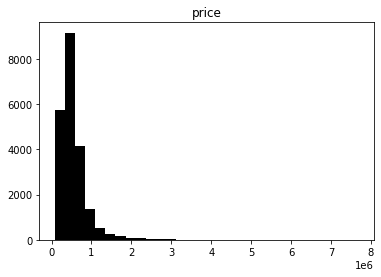

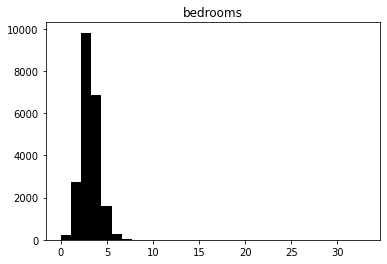

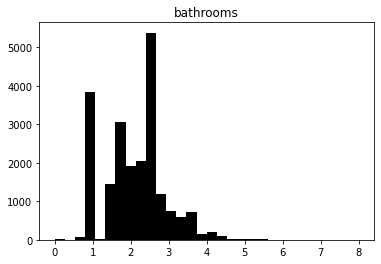

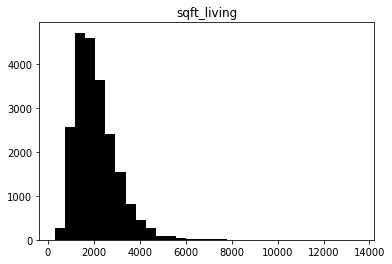

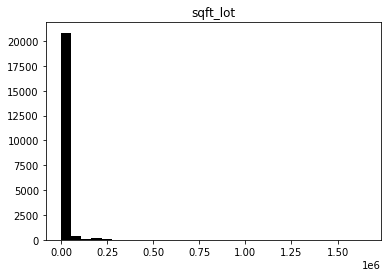

...

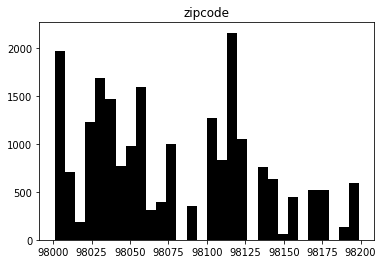

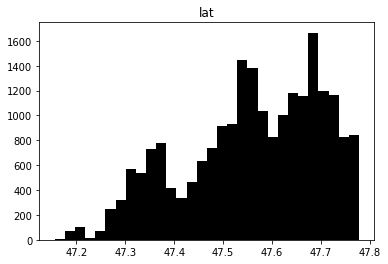

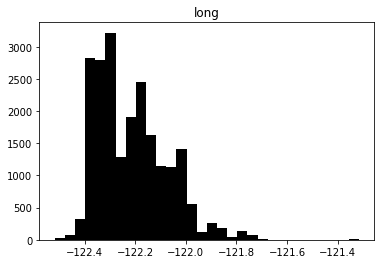

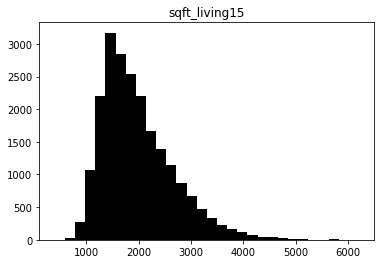

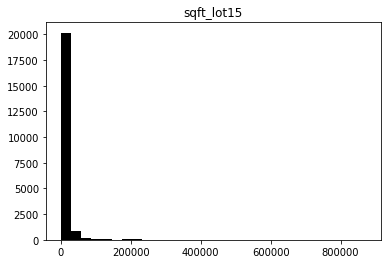

In [9]:
# Checking for Outliers using histograms
#

import matplotlib.pyplot as plt
import seaborn as sb
%matplotlib inline


for i in range(0, House.shape[1]):
  plt.hist(House.iloc[:, i], bins=30, color='Black')
  plt.title(House.columns[i])
  plt.show()



In [10]:
# Checking for missing data
House.isnull().sum()

price            0
bedrooms         0
bathrooms        0
sqft_living      0
sqft_lot         0
floors           0
waterfront       0
view             0
condition        0
grade            0
sqft_above       0
sqft_basement    0
yr_built         0
yr_renovated     0
zipcode          0
lat              0
long             0
sqft_living15    0
sqft_lot15       0
dtype: int64

In [11]:
#checking for duplicates
House.duplicated().sum()

5

In [12]:
# Removing duplicates
House.drop_duplicates(inplace=True)

## 6. Exploratory Data Analysis

### Univariate Analysis

In [13]:
#Finding the mean
House.mean()

price            540192.407812
bedrooms              3.370927
bathrooms             2.114738
sqft_living        2079.958950
sqft_lot          15109.616300
floors                1.494146
waterfront            0.007544
view                  0.234219
condition             3.409478
grade                 7.656655
sqft_above         1788.414846
sqft_basement       291.544104
yr_built           1970.999907
yr_renovated         84.330155
zipcode           98077.942614
lat                  47.560050
long               -122.213894
sqft_living15      1986.583164
sqft_lot15        12770.108340
dtype: float64

In [14]:
#mode
House.mode()

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,350000.0,3.0,2.5,1300.0,5000.0,1.0,0.0,0.0,3.0,7.0,1300.0,0.0,2014.0,0.0,98103.0,47.5322,-122.29,1540.0,5000.0
1,450000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,47.5491,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,47.6624,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,47.6846,NaN,NaN,NaN


In [15]:
#median
House.median()

price            450000.0000
bedrooms              3.0000
bathrooms             2.2500
sqft_living        1910.0000
sqft_lot           7620.0000
floors                1.5000
waterfront            0.0000
view                  0.0000
condition             3.0000
grade                 7.0000
sqft_above         1560.0000
sqft_basement         0.0000
yr_built           1975.0000
yr_renovated          0.0000
zipcode           98065.0000
lat                  47.5718
long               -122.2305
sqft_living15      1840.0000
sqft_lot15         7620.0000
dtype: float64

In [16]:
#variance
House.var()

price            1.349825e+11
bedrooms         8.650908e-01
bathrooms        5.932672e-01
sqft_living      8.436529e+05
sqft_lot         1.716024e+09
floors           2.915032e-01
waterfront       7.486944e-03
view             5.870143e-01
condition        4.235173e-01
grade            1.381762e+00
sqft_above       6.858178e+05
sqft_basement    1.959059e+05
yr_built         8.626828e+02
yr_renovated     1.612159e+05
zipcode          2.862986e+03
lat              1.920387e-02
long             1.983313e-02
sqft_living15    4.698026e+05
sqft_lot15       7.456726e+08
dtype: float64

In [17]:
#standard deviation
House.std()

price            367399.634340
bedrooms              0.930103
bathrooms             0.770238
sqft_living         918.505805
sqft_lot          41424.914310
floors                0.539910
waterfront            0.086527
view                  0.766169
condition             0.650782
grade                 1.175484
sqft_above          828.141155
sqft_basement       442.612560
yr_built             29.371463
yr_renovated        401.517026
zipcode              53.506883
lat                   0.138578
long                  0.140830
sqft_living15       685.421474
sqft_lot15        27307.006892
dtype: float64

In [18]:
#kurtosis
House.kurt()

price             34.515384
bedrooms          49.065621
bathrooms          1.279265
sqft_living        5.242209
sqft_lot         285.018678
floors            -0.484874
waterfront       127.601820
view              10.900687
condition          0.525365
grade              1.191884
sqft_above         3.401928
sqft_basement      2.714433
yr_built          -0.657181
yr_renovated      18.721546
zipcode           -0.853570
lat               -0.676783
long               1.049927
sqft_living15      1.596974
sqft_lot15       150.732711
dtype: float64

In [19]:
#skewness
House.skew()

price             4.021355
bedrooms          1.974363
bathrooms         0.511146
sqft_living       1.471467
sqft_lot         13.058691
floors            0.616340
waterfront       11.383761
view              3.396677
condition         1.032646
grade             0.771580
sqft_above        1.446740
sqft_basement     1.577731
yr_built         -0.469782
yr_renovated      4.551734
zipcode           0.405684
lat              -0.485183
long              0.885277
sqft_living15     1.108258
sqft_lot15        9.505818
dtype: float64

In [20]:
# Ploting the univariate summaries and recording our observations
#
# installing pandas profiling
! pip install -U pandas-profiling


Requirement already up-to-date: pandas-profiling in /usr/local/lib/python3.7/dist-packages (3.0.0)


In [21]:
# Generating the profile report on the housing dataset
from pandas_profiling import ProfileReport
profile = ProfileReport(House)


In [22]:
profile

Summarize dataset:   0%|          | 0/33 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### Bivariate Analysis

In [23]:
#correlation matrix
correlations=House.corr()
correlations

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
price,1.000000,0.308314,0.525143,0.702044,0.089647,0.256885,0.266332,0.397462,0.036375,0.667570,0.605557,0.323860,0.054032,0.126498,-0.053144,0.306917,0.021531,0.585373,0.082443
bedrooms,0.308314,1.000000,0.515956,0.576640,0.031671,0.175608,-0.006591,0.079411,0.028370,0.357143,0.477569,0.303093,0.154410,0.018678,-0.152683,-0.008970,0.129395,0.391571,0.029197
bathrooms,0.525143,0.515956,1.000000,0.754717,0.087751,0.500754,0.063747,0.187892,-0.124941,0.665029,0.685376,0.283824,0.506038,0.050880,-0.203837,0.024587,0.223065,0.568692,0.087192
sqft_living,0.702044,0.576640,0.754717,1.000000,0.172809,0.354181,0.103817,0.284627,-0.058825,0.762893,0.876593,0.435061,0.318253,0.055299,-0.199396,0.052514,0.240150,0.756398,0.183258
sqft_lot,0.089647,0.031671,0.087751,0.172809,1.000000,-0.005113,0.021598,0.074744,-0.008988,0.113688,0.183508,0.015263,0.053154,0.007671,-0.129595,-0.085683,0.229530,0.144596,0.718552
floors,0.256885,0.175608,0.500754,0.354181,-0.005113,1.000000,0.023731,0.029383,-0.263728,0.458074,0.524117,-0.245646,0.489244,0.006193,-0.059153,0.049595,0.125592,0.280080,-0.011180
waterfront,0.266332,-0.006591,0.063747,0.103817,0.021598,0.023731,1.000000,0.401992,0.016648,0.082799,0.072076,0.080584,-0.026150,0.092949,0.030283,-0.014272,-0.041916,0.086466,0.030698
view,0.397462,0.079411,0.187892,0.284627,0.074744,0.029383,0.401992,1.000000,0.045819,0.251426,0.167642,0.276993,-0.053196,0.103203,0.084857,0.006047,-0.078598,0.280391,0.072566
condition,0.036375,0.028370,-0.124941,-0.058825,-0.008988,-0.263728,0.016648,0.045819,1.000000,-0.144599,-0.158273,0.174061,-0.361306,-0.060875,0.002998,-0.014975,-0.106590,-0.092920,-0.003449
grade,0.667570,0.357143,0.665029,0.762893,0.113688,0.458074,0.082799,0.251426,-0.144599,1.000000,0.756090,0.168483,0.446887,0.014396,-0.184875,0.114100,0.198496,0.713396,0.119319


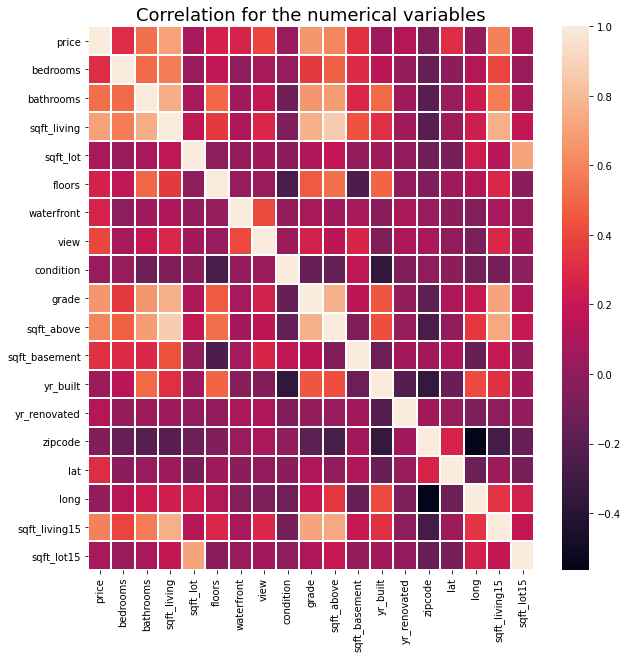

In [24]:
plt.figure(figsize=(10,10))
sb.heatmap(correlations,xticklabels=correlations.columns,yticklabels=correlations.columns,linewidth=1.0,annot=False)
plt.title('Correlation for the numerical variables',fontsize=18)
plt.show()

## 7. Implementing the Solution

###Multicollinearity Check

In [25]:
#Focusing mainly on the independent variables
Independent_corr = House.iloc[:,1:].corr()

#Get the VIF scores
pd.DataFrame(np.linalg.inv(Independent_corr.values), index = Independent_corr.index, columns=Independent_corr.columns)

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
bedrooms,1.652031,-0.461426,-1.088603e+00,0.049328,0.049899,0.063074,0.114430,-0.050617,0.306791,1.043394e-01,3.931447e-02,0.134482,0.045798,0.080165,0.050859,0.017531,0.025352,0.085414
bathrooms,-0.461426,3.351350,-1.850405e+00,-0.024052,-0.675550,0.010093,-0.042357,-0.137281,-0.268260,3.979465e-01,-1.874113e-01,-0.935767,-0.260444,0.041786,-0.041043,0.053840,0.092103,0.071422
sqft_living,-1.084569,-1.852544,-1.600251e+13,-0.169880,0.543984,-0.421243,0.401296,-0.512387,-1.677454,1.442815e+13,7.711341e+12,0.657857,-0.132186,-0.287725,0.006204,0.025811,-0.970823,-0.088666
sqft_lot,0.049328,-0.024052,-1.711705e-01,2.102507,0.045220,0.027370,-0.059114,0.030525,-0.053800,-4.498818e-02,3.991992e-02,0.098743,0.021296,-0.002579,0.053332,-0.133214,0.163908,-1.459284
floors,0.049899,-0.675550,5.432857e-01,0.045220,2.011862,-0.005512,-0.040132,0.089859,-0.229894,-9.946767e-01,3.534484e-01,-0.480925,-0.079948,-0.170773,-0.127586,0.163981,0.272344,0.072693
waterfront,0.063074,0.010093,-4.212411e-01,0.027370,-0.005512,1.203969,-0.492854,-0.012820,0.049289,2.677303e-01,1.992977e-01,-0.021095,-0.065850,0.022562,0.009812,0.027235,0.054387,-0.018479
view,0.114430,-0.042357,4.016365e-01,-0.059114,-0.040132,-0.492854,1.435320,-0.021127,-0.185409,-3.226409e-01,-4.498923e-01,0.151634,-0.039121,-0.140637,0.118652,0.071957,-0.325319,-0.007474
condition,-0.050617,-0.137281,-5.132359e-01,0.030525,0.089859,-0.012820,-0.021127,1.249459,-0.054483,5.181963e-01,1.498291e-01,0.561463,0.206910,0.161273,0.063725,-0.006892,0.075906,-0.028238
grade,0.306791,-0.268260,-1.680455e+00,-0.053800,-0.229894,0.049289,-0.185409,-0.054483,3.418525,-9.597804e-02,3.234771e-01,-0.638340,-0.071434,0.083173,-0.331091,0.393332,-0.912175,0.071929
sqft_above,0.102826,0.397610,1.442815e+13,-0.046208,-0.995608,0.267782,-0.322346,0.517446,-0.098703,-1.300867e+13,-6.952682e+12,-0.073727,0.118019,0.183765,0.175618,-0.364643,-0.659680,-0.095830


Since our VIF scores are less than five we assume there isn't much multicollinearity hence there is no need for dropping any variables.

In [26]:
#splitting dataset
X=House.iloc[:,1:].values
y=House.iloc[:,0].values

In [27]:
# Train using 80% of the data.
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

### 1. Multiple Linear Regression

In [28]:
from numpy import mean
from numpy import std
from numpy import absolute
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedKFold
from sklearn.linear_model import LinearRegression

#define the model
regressor = LinearRegression()
regressor.fit(X_train,y_train)
# define model evaluation method
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)
# evaluate model
scores = cross_val_score(regressor, X_test, y_test, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1)
# force scores to be positive
scores = absolute(scores)
print('Mean MAE: %.3f (%.3f)' % (mean(scores), std(scores)))

Mean MAE: 121642.139 (6120.255)


#### Residual Plots

3954.2673439062264


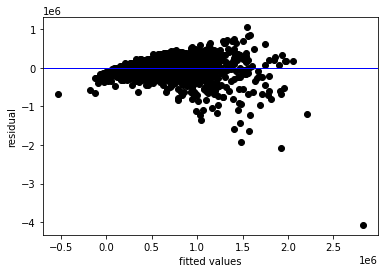

In [29]:
# residual plots
y_pred=regressor.predict(X_test)
residuals = np.subtract(y_pred, y_test)
print(residuals.mean())
#plotting the residuals
plt.scatter(y_pred, residuals, color='black')
plt.ylabel('residual')
plt.xlabel('fitted values')
plt.axhline(y= residuals.mean(), color='blue', linewidth=1)
plt.show()

#### Bartlett's Test for Heteroskedasticity

In [30]:
#Bartlett's test
import scipy as sp

test_result, p_value = sp.stats.bartlett(y_pred, residuals)

# To interpret the results we must also compute a critical value of the chi squared distribution
degree_of_freedom = len(y_pred)-1
probability = 1 - p_value

critical_value = sp.stats.chi2.ppf(probability, degree_of_freedom)
print(critical_value)

# If the test_result is greater than the critical value, then we reject our null
# hypothesis. This would mean that there are patterns to the variance of the data

# Otherwise, we can identify no patterns, and we accept the null hypothesis that 
# the variance is homogeneous across our data

if (test_result > critical_value):
  print('the variances are unequal, and the model should be reassessed')
else:
  print('the variances are homogeneous!')



inf
the variances are homogeneous!


Since the variances are homogeneous there is no heteroskedasticity in the Data.

### 2. Lasso Regression

In [31]:
from sklearn.linear_model import Lasso

# define model
model_1 = Lasso(alpha=1.0)
model_1.fit(X_train,y_train)
# define model evaluation method
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)
# evaluate model
scores = cross_val_score(model_1, X_test, y_test, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1)
# force scores to be positive
scores = absolute(scores)
print('Mean MAE: %.4f (%.4f)' % (mean(scores), std(scores)))

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323735224333016.8, tolerance: 239052944736.90985
  positive)


Mean MAE: 121641.0736 (6120.3145)


#### Residual plots

3954.6292554504294


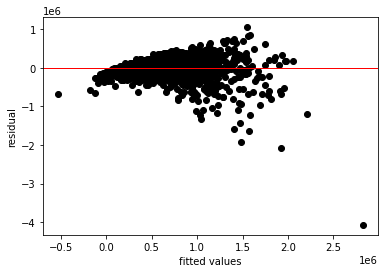

In [32]:
# residual plots and test for heteroskedasticity
y_pred1=model_1.predict(X_test)
residuals_1= np.subtract(y_pred1, y_test)
print(residuals_1.mean())
#plotting the residuals
plt.scatter(y_pred1, residuals_1, color='black')
plt.ylabel('residual')
plt.xlabel('fitted values')
plt.axhline(y= residuals_1.mean(), color='red', linewidth=1)
plt.show()

#### Bartlett's Test for Heteroskedasticity

In [33]:
#Bartlett's test
test_result, p_value = sp.stats.bartlett(y_pred1, residuals_1)

# To interpret the results we must also compute a critical value of the chi squared distribution
df1 = len(y_pred1)-1
probability = 1 - p_value

critical_value = sp.stats.chi2.ppf(probability, df1)
print(critical_value)

# If the test_result is greater than the critical value, then we reject our null
# hypothesis. This would mean that there are patterns to the variance of the data

# Otherwise, we can identify no patterns, and we accept the null hypothesis that 
# the variance is homogeneous across our data

if (test_result > critical_value):
  print('the variances are unequal, and the model should be reassessed')
else:
  print('the variances are homogeneous!')


inf
the variances are homogeneous!


Since the variances are homogeneous there is no heteroskedasticity in the Data

### 3.  Ridge Regression

In [34]:
from sklearn.linear_model import Ridge

# define model
model_2 = Ridge()
model_2.fit(X_train,y_train)
# define model evaluation method
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)
# evaluate model
scores = cross_val_score(model_2, X_test, y_test, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1)
# force scores to be positive
scores = absolute(scores)
print('Mean MAE: %.3f (%.3f)' % (mean(scores), std(scores)))

Mean MAE: 121566.337 (6129.439)


#### Residual plots

3969.4050239002945


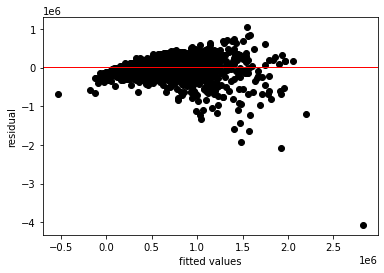

In [35]:
# residual plots and test for heteroskedasticity
y_pred2=model_2.predict(X_test)
residuals = np.subtract(y_pred2, y_test)
print(residuals.mean())
#plotting the residuals
plt.scatter(y_pred2, residuals, color='black')
plt.ylabel('residual')
plt.xlabel('fitted values')
plt.axhline(y= residuals.mean(), color='red', linewidth=1)
plt.show()

#### Bartlett's Test for Heteroskedasticity

In [36]:
test_result, p_value = sp.stats.bartlett(y_pred2, residuals)

# To interpret the results we must also compute a critical value of the chi squared distribution
degree_of_freedom = len(y_pred2)-1
probability = 1 - p_value

critical_value = sp.stats.chi2.ppf(probability, degree_of_freedom)
print(critical_value)

# If the test_result is greater than the critical value, then we reject our null
# hypothesis. This would mean that there are patterns to the variance of the data

# Otherwise, we can identify no patterns, and we accept the null hypothesis that 
# the variance is homogeneous across our data

if (test_result > critical_value):
  print('the variances are unequal, and the model should be reassessed')
else:
  print('the variances are homogeneous!')


inf
the variances are homogeneous!


Since the variances are homogeneous there is no heteroskedasticity in the Data.

### 4. Elastic Net Regression

In [37]:
from sklearn.linear_model import ElasticNet

# define model
model3 = ElasticNet(alpha=1.0, l1_ratio=0.5)
model3.fit(X_train,y_train)
# define model evaluation method
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)
# evaluate model
scores = cross_val_score(model3, X_test, y_test, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1)
# force scores to be positive
scores = absolute(scores)
print('Mean MAE: %.3f (%.3f)' % (mean(scores), std(scores)))

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 482555224902402.06, tolerance: 239052944736.90985
  positive)


Mean MAE: 139998.171 (7546.602)


The absolute error is higher than all the other models hence this model is least preferred in making predictions on our data.

#### Residual plots

5945.475043158332


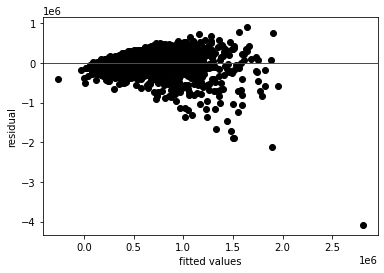

In [38]:
# residual plots and test for heteroskedasticity
y_pred3=model3.predict(X_test)
residuals = np.subtract(y_pred3, y_test)
print(residuals.mean())
#plotting the residuals
plt.scatter(y_pred3, residuals, color='black')
plt.ylabel('residual')
plt.xlabel('fitted values')
plt.axhline(y= residuals.mean(), color='red', linewidth=1)
plt.show()

#### Bartlett's Test for Heteroskedasticity

In [39]:
test_result, p_value = sp.stats.bartlett(y_pred3, residuals)

# To interpret the results we must also compute a critical value of the chi squared distribution
degree_of_freedom = len(y_pred3)-1
probability = 1 - p_value

critical_value = sp.stats.chi2.ppf(probability, degree_of_freedom)
print(critical_value)

# If the test_result is greater than the critical value, then we reject our null
# hypothesis. This would mean that there are patterns to the variance of the data

# Otherwise, we can identify no patterns, and we accept the null hypothesis that 
# the variance is homogeneous across our data

if (test_result > critical_value):
  print('the variances are unequal, and the model should be reassessed')
else:
  print('the variances are homogeneous!')


inf
the variances are homogeneous!


Since the variances are homogeneous there is no heteroskedasticity in the Data.

### 5. Quantile regression

In [40]:
!pip install mlinsights==0.3.549
from mlinsights.mlmodel import QuantileLinearRegression

In [41]:
clq = QuantileLinearRegression()
res=clq.fit(X_train, y_train)
#define evaluation method
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)
# evaluate model
scores = cross_val_score(clq, X_test, y_test, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1)
# force scores to be positive
scores = absolute(scores)
print('Mean MAE: %.3f (%.3f)' % (mean(scores), std(scores)))

Mean MAE: 113841.610 (7397.662)



The absolute error is the least among all the models hence this model is the most preferred in making predictions on our data.

#### Residual plots

-14560.313190935412


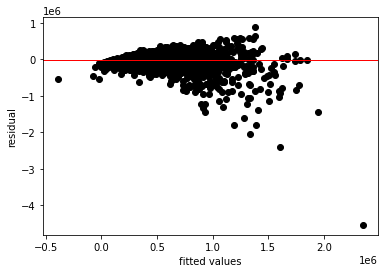

In [42]:
# residual plots and test for heteroskedasticity
y_pred4=clq.predict(X_test)
residuals = np.subtract(y_pred4, y_test)
print(residuals.mean())
#plotting the residuals
plt.scatter(y_pred4, residuals, color='black')
plt.ylabel('residual')
plt.xlabel('fitted values')
plt.axhline(y= residuals.mean(), color='red', linewidth=1)
plt.show()

#### Bartlett's Test for Heteroskedasticity

In [43]:
test_result, p_value = sp.stats.bartlett(y_pred4, residuals)

# To interpret the results we must also compute a critical value of the chi squared distribution
degree_of_freedom = len(y_pred4)-1
probability = 1 - p_value

critical_value = sp.stats.chi2.ppf(probability, degree_of_freedom)
print(critical_value)

# If the test_result is greater than the critical value, then we reject our null
# hypothesis. This would mean that there are patterns to the variance of the data

# Otherwise, we can identify no patterns, and we accept the null hypothesis that 
# the variance is homogeneous across our data

if (test_result > critical_value):
  print('the variances are unequal, and the model should be reassessed')
else:
  print('the variances are homogeneous!')

inf
the variances are homogeneous!


Since the variances are homogeneous there is no heteroskedasticity in the Data.

### Conclusion

From our solution implementation, we can see that the quantile regression model has the least error score thus rendering it our best model. 

## 8. Challenging the solution


* Our model's performance could be improved by increasing the number of observations used to train and test it.
* We could also increase the number of iterations to get a better average performance.




